In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


In [2]:
import sys
data_path = "../../../TabulaSapiensData/"
ts_path = "../"
sys.path.append(ts_path)


In [3]:
import matplotlib.pyplot as plt

%matplotlib inline

In [4]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


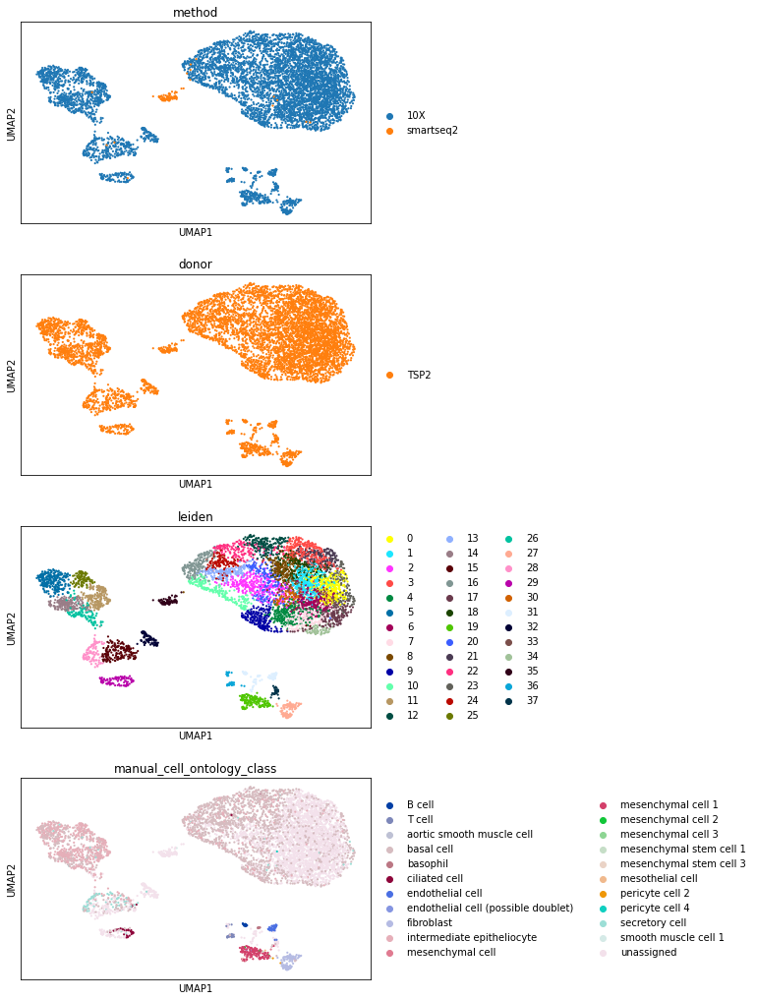

In [5]:
organ = "Trachea"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [6]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

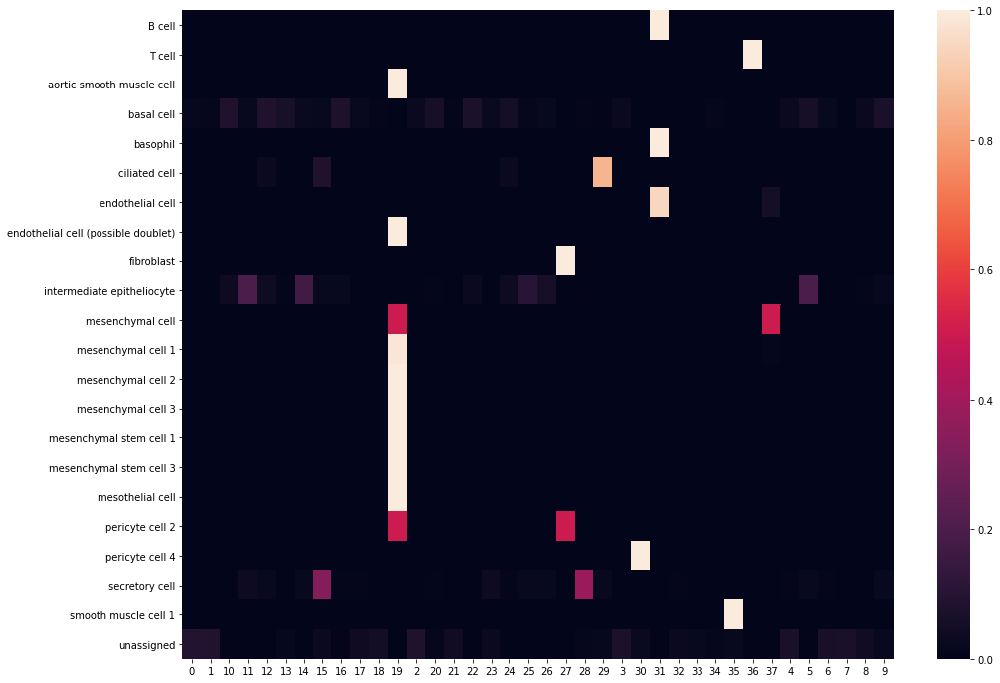

In [7]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.sum(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [8]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [9]:
cluster_composition["0"]

['basal cell: 0.10', 'unassigned: 0.90']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [10]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [11]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

In [12]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


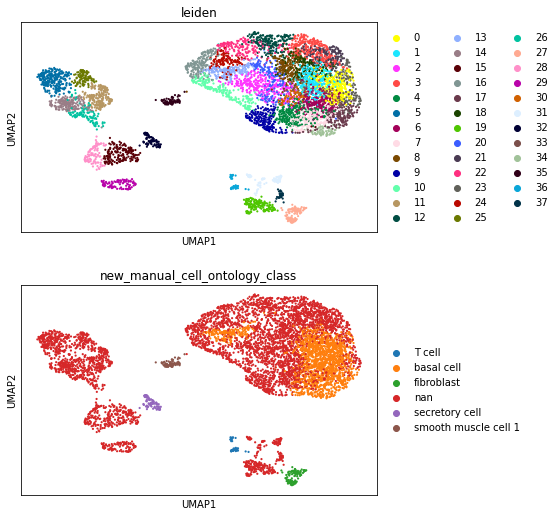

In [13]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

In [14]:
organ_adata.obs.groupby(["leiden"]).agg(
    {"new_manual_cell_ontology_class": set, "Propagated.Annotation": set}
)

,new_manual_cell_ontology_class,Propagated.Annotation
leiden,,
0,{basal cell},{basal cell}
1,{basal cell},{basal cell}
2,{nan},{basal cell}
3,{nan},{basal cell}
4,{nan},{basal cell}
5,{nan},{intermediate epitheliocyte}
6,{basal cell},{basal cell}
7,{basal cell},{basal cell}
8,{nan},{basal cell}


/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


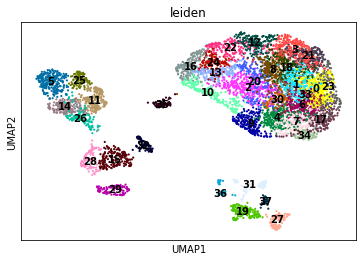

In [15]:
sc.pl.umap(organ_adata, color="leiden", legend_loc="on data")

# Sankey Diagram between cluster and compartment

In [16]:
from utils.colorDict import (
    donor_colors,
    method_colors,
    compartment_colors,
    tissue_colors,
)

In [17]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

In [18]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Trachea.html'

# visualize compartment markers

In [19]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [20]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



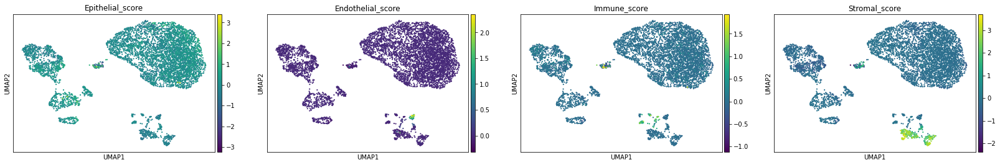

In [21]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [22]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [23]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [24]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

### top positive marker genes

In [25]:
organ_cluster_genes = pd.DataFrame(organ_adata.uns['rank_genes_groups']['names'])
organ_cluster_genes.iloc[:20]


,0,1,2,3,4,5,6,7,8,9,...,28,29,30,31,32,33,34,35,36,37
0,KRT13,MT-RNR2,LRRC75A,KRT6A,MT-ND3,KRT15,NEAT1,MALAT1,KRT14,KRT15,...,LCN2,CAPS,MT-ND4L,VIM,PIGR,NCL,JUN,RPL13A,SRGN,DCN
1,DSP,MT-RNR1,SEC31B,S100A2,MT-RNR1,BCAM,MT-RNR1,NEAT1,S100A2,MIR205HG,...,WFDC2,TMEM190,MT-RNR2,TMSB4X,MUC5B,GOLGB1,TXNIP,EEF1A1P6,PTPRC,MGP
2,MT-ND4L,MT-ND5,CALML3-AS1,LY6D,MT-CO3,GAS5,MT-ND5,FTX,IGFBP6,BCAM,...,KRT7,C20orf85,MTATP6P1,CD74,SCGB3A1,PPP1R15A,EGR1,EEF1A1P5,CD53,VIM
3,SERPINB3,MTATP6P1,TOP2A,KRT13,MT-ATP6,RPL10P9,MT-RNR2,GOLGB1,KRT6A,TP63,...,MSMB,PIGR,MT-ND5,HLA-E,AZGP1,MT-ND6,NEAT1,EEF1A1,S100A4,CFD
4,NEAT1,KRT13,NHS,KRT14,MT-RNR2,BTF3,MT-ND4L,PPP1R15A,MTATP6P1,RASSF6,...,SLPI,C9orf24,RGL2,B2M,LCN2,MALAT1,AHNAK,RPL10P6,CD3D,C1R
5,MT-ND5,MT-ATP6,KIAA0895L,FGFBP1,MTATP6P1,SERPINF1,XIST,JUN,MT-ATP6,DST,...,PSCA,LCN2,FKBP5,SRGN,TCN1,DSP,DSP,RPL3,B2M,IGFBP5
6,KRT6A,MT-ND4L,AC021504.1,SFN,MT-ND1,RPL10,LRRC75A,MT-ND6,FGFBP1,XIST,...,PIGR,WFDC2,MT-ATP6,HLA-DRA,XBP1,MMP10,CALML3,RPL3P4,CD2,PLA2G2A
7,LY6D,LRRC75A,CTBP1-AS,KRT17,MT-CO1,RPS3A,MT-ATP6,DST,S100A10,MT-RNR1,...,BPIFB1,TUBA1A,MT-RNR1,ARHGDIB,BPIFB1,ARGLU1,DGKH,RPL13AP5,CYTIP,FSTL1
8,MT-RNR2,MT-ND3,TSIX,ENO1,MT-CO2,RPL30,MT-ND3,MT-ND5,MT-ND3,PTPRZ1,...,AGR2,PIFO,MT-ND6,FXYD5,LYZ,MUC4,INTS6,RPS6,SMAP2,GPX3
9,MT-RNR1,LY6D,TMEM184A,TUBA1B,MT-ND4,RPLP1,ABCA13,MT-ND4L,MMP10,GABPB1-AS1,...,CXCL17,PSCA,ZNF555,HLA-B,CP,MIA3,XIST,RPS18,IL7R,C3


In [26]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
KRT13,15.813677,1.831024,1.474198e-51
DSP,14.869370,1.272216,1.123764e-45
MT-ND4L,14.863040,1.197770,1.123764e-45
SERPINB3,14.464062,1.298851,3.007855e-43
NEAT1,14.405150,1.100186,5.654694e-43
MT-ND5,14.255403,1.008926,4.070881e-42
KRT6A,13.437640,1.488935,3.060038e-37
LY6D,12.494552,1.421206,5.882975e-32
MT-RNR2,12.305052,0.733352,5.340045e-31
MT-RNR1,12.299880,0.734071,5.340045e-31


1


,wilcoxon_score,log fold change,adjusted pvalue
MT-RNR2,13.240819,0.807892,3.001773e-35
MT-RNR1,12.713122,0.761756,1.471671e-32
MT-ND5,12.271240,0.894816,2.536475e-30
MTATP6P1,11.414949,0.892128,5.182185e-26
KRT13,11.351449,1.297472,8.588423e-26
MT-ATP6,10.565696,0.742423,4.216754e-22
MT-ND4L,10.411111,0.837305,1.855508e-21
LRRC75A,9.673236,0.839309,2.883083e-18
MT-ND3,9.417562,0.699842,3.019917e-17
LY6D,9.314532,0.916109,7.211067e-17


2


,wilcoxon_score,log fold change,adjusted pvalue
LRRC75A,0.879970,0.064654,1.0
SEC31B,0.626153,1.129582,1.0
CALML3-AS1,0.585824,1.010938,1.0
TOP2A,0.564044,-0.237879,1.0
NHS,0.556542,0.079365,1.0
KIAA0895L,0.525725,0.251968,1.0
AC021504.1,0.518713,0.942003,1.0
CTBP1-AS,0.478732,1.381975,1.0
TSIX,0.458678,0.147852,1.0
TMEM184A,0.453312,0.157338,1.0


3


,wilcoxon_score,log fold change,adjusted pvalue
KRT6A,21.096907,2.935614,4.998868e-94
S100A2,19.569096,2.460921,8.349701e-81
LY6D,19.454271,2.998249,5.261719e-80
KRT13,19.437523,2.737964,5.470333e-80
KRT14,18.407925,2.811799,1.336203e-71
FGFBP1,15.663838,1.666147,2.622347e-51
SFN,15.467425,1.605298,4.841089e-50
KRT17,14.976247,1.777460,7.725296e-47
ENO1,14.850708,1.223458,4.502774e-46
TUBA1B,14.746040,1.476594,1.920651e-45


4


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND3,13.106627,1.058676,8.123367e-35
MT-RNR1,13.082612,0.922885,8.123367e-35
MT-CO3,12.743069,0.898314,5.014586e-33
MT-ATP6,11.982910,0.895310,5.141913e-29
MT-RNR2,11.435305,0.817963,2.733118e-26
MTATP6P1,11.414318,0.958694,2.982821e-26
MT-ND1,11.269402,0.837226,1.367462e-25
MT-CO1,10.982886,0.730829,3.021506e-24
MT-CO2,10.529702,0.762670,3.710771e-22
MT-ND4,10.464379,0.729508,6.176412e-22


5


,wilcoxon_score,log fold change,adjusted pvalue
KRT15,23.941414,3.416934,4.518173e-122
BCAM,23.928837,3.169288,4.518173e-122
GAS5,23.487619,2.704709,1.071159e-117
RPL10P9,23.199041,3.056008,6.852218e-115
BTF3,22.861826,2.645189,1.312425e-111
SERPINF1,22.785378,2.751377,6.282300e-111
RPL10,22.686378,2.586184,5.135462e-110
RPS3A,22.675009,2.678159,5.818339e-110
RPL30,22.595505,2.521614,3.138407e-109
RPLP1,22.586119,2.355446,3.493139e-109


6


,wilcoxon_score,log fold change,adjusted pvalue
NEAT1,12.014359,1.050293,1.758327e-28
MT-RNR1,11.300681,0.798304,3.832566e-25
MT-ND5,11.222570,0.943084,6.200039e-25
MT-RNR2,10.484947,0.746003,1.490910e-21
MT-ND4L,9.776077,0.913547,1.679352e-18
XIST,9.727015,0.824861,2.269241e-18
LRRC75A,9.136159,0.906639,5.442124e-16
MT-ATP6,8.818192,0.680087,8.559906e-15
MT-ND3,8.703918,0.746941,2.097199e-14
ABCA13,8.190455,1.061646,1.532025e-12


7


,wilcoxon_score,log fold change,adjusted pvalue
MALAT1,10.536736,0.980625,1.812370e-22
NEAT1,9.604554,0.849666,1.047177e-18
FTX,9.520367,1.214711,2.161524e-18
GOLGB1,8.059640,0.790134,3.240792e-13
PPP1R15A,7.664725,1.013902,6.028800e-12
JUN,7.601182,0.740515,9.491602e-12
MT-ND6,7.436946,0.864350,3.063597e-11
DST,7.322059,0.640353,6.911398e-11
MT-ND5,7.303096,0.600147,7.846163e-11
MT-ND4L,7.296443,0.656521,8.166506e-11


8


,wilcoxon_score,log fold change,adjusted pvalue
KRT14,12.139778,1.981303,3.826658e-29
S100A2,10.152255,1.448573,9.530909e-20
IGFBP6,9.253537,1.131156,3.196410e-16
KRT6A,8.417960,1.165477,3.334304e-13
MTATP6P1,8.413939,0.744150,3.334304e-13
MT-ATP6,7.759721,0.618971,4.555281e-11
FGFBP1,7.726102,0.890640,5.440074e-11
S100A10,7.028469,0.687801,7.231021e-09
MT-ND3,6.547512,0.553269,1.640053e-07
MMP10,6.344997,0.842377,5.542454e-07


9


,wilcoxon_score,log fold change,adjusted pvalue
KRT15,16.882164,2.182010,3.583536e-59
MIR205HG,15.019682,1.639683,1.070829e-46
BCAM,14.888903,1.837850,5.726646e-46
TP63,13.156504,1.606455,1.313187e-35
RASSF6,13.092332,1.995224,2.680446e-35
DST,13.004894,1.491068,7.506432e-35
XIST,12.733809,1.238085,2.053244e-33
MT-RNR1,12.155699,0.959096,2.624726e-30
PTPRZ1,12.060378,1.440935,7.743508e-30
GABPB1-AS1,12.053035,1.365084,7.860716e-30


10


,wilcoxon_score,log fold change,adjusted pvalue
KRT15,10.594724,1.109580,3.145765e-23
BCAM,9.226143,0.921206,1.205553e-17
MIR205HG,7.321188,0.684507,3.244251e-11
TP63,7.025689,0.739696,2.388586e-10
RASSF6,6.699520,0.877265,1.929469e-09
DST,5.771163,0.585920,4.557139e-07
COL17A1,4.818073,0.487888,5.480605e-05
CYP24A1,4.097957,0.966111,1.116877e-03
RNF165,3.928947,1.213699,2.110008e-03
BCL11A,3.902189,0.390878,2.335360e-03


11


,wilcoxon_score,log fold change,adjusted pvalue
GSTP1,21.644611,3.665671,4.021892e-99
RPL23A,21.591404,3.606820,6.368034e-99
ATP5MC3,21.559559,3.560105,8.451761e-99
RPLP0,21.512787,3.118582,1.739399e-98
RPS7,21.491011,3.537832,2.027958e-98
RPL7A,21.486845,3.421134,2.027958e-98
RPS3A,21.460627,3.563179,3.055998e-98
SNHG29,21.443113,3.186840,3.896399e-98
RPS10,21.432295,4.025747,4.369767e-98
RPS13,21.421041,3.282239,5.007801e-98


12


,wilcoxon_score,log fold change,adjusted pvalue
S100A2,22.524046,4.794299,1.420505e-107
KRT6A,22.408689,5.111988,9.531768e-107
KRT14,22.178659,5.581598,1.083198e-104
S100A10,22.138458,4.087966,1.983413e-104
FGFBP1,22.083372,4.130503,5.377251e-104
SH3BGRL3,21.742605,3.447316,7.963028e-101
KRT17,21.139845,3.842558,2.877934e-95
SFN,21.120598,3.478365,3.785301e-95
TMSB10,21.031580,3.150275,2.205892e-94
EIF5A,20.956463,2.747721,9.643968e-94


13


,wilcoxon_score,log fold change,adjusted pvalue
KRT6A,4.211978,0.560756,0.000554
KRT16,3.145092,0.404797,0.023570
KRT13,3.055363,0.554555,0.030844
SPRR2A,2.497622,0.640025,0.138173
FGFBP1,2.172745,0.133266,0.289201
SPRR1B,1.985227,0.499078,0.425380
LY6D,1.978297,0.277743,0.431214
KRT6B,1.603734,0.165952,0.853602
LYPD3,1.603569,0.136685,0.853737
S100A2,1.599374,0.377376,0.860220


14


,wilcoxon_score,log fold change,adjusted pvalue
PPDPF,21.544132,3.689304,3.538029e-98
EPHX1,21.479445,4.112867,7.134602e-98
RPL28,21.170092,3.176912,3.536198e-95
DAPL1,21.141245,4.570875,4.658185e-95
ATP5MC2,21.132996,3.683170,4.658185e-95
KRT19,21.050987,3.801836,1.955373e-94
PRSS23,21.049213,3.645718,1.955373e-94
ALKBH7,20.970009,3.697446,9.068933e-94
RPL10P9,20.954338,3.792912,1.120467e-93
CD81,20.887506,3.253451,4.094927e-93


15


,wilcoxon_score,log fold change,adjusted pvalue
LCN2,21.010323,6.557190,3.106917e-93
KRT7,20.472366,4.410470,1.117723e-88
WFDC2,20.262585,4.662283,5.399001e-87
SLPI,20.079330,4.604698,1.646757e-85
MUC16,19.661505,4.069236,5.426060e-82
PIGR,19.377165,6.129116,1.011676e-79
CXCL17,18.988161,3.795568,1.572418e-76
PSCA,18.730865,6.836824,1.814297e-74
AGR2,18.328485,3.531413,2.886842e-71
MSMB,18.301502,5.663512,4.308125e-71


16


,wilcoxon_score,log fold change,adjusted pvalue
MMP10,7.733949,1.467643,5.365240e-13
COL17A1,4.252439,0.436892,3.631370e-04
KRT14,2.305824,0.261680,1.964238e-01
TNFRSF12A,2.205643,-0.001102,2.467607e-01
IL1R2,2.077335,0.426049,3.257484e-01
MMP1,2.042140,1.257609,3.503220e-01
KRT16P6,2.041266,0.870112,3.509077e-01
CYP24A1,2.000354,0.454001,3.828279e-01
KRT17,1.953081,0.176145,4.221859e-01
ID1,1.705986,-0.043033,6.751343e-01


17


,wilcoxon_score,log fold change,adjusted pvalue
NEAT1,13.222729,1.466743,3.818733e-35
XIST,12.989320,1.414219,4.140680e-34
MALAT1,12.519104,1.435077,1.151777e-31
GOLGB1,11.341135,1.481449,1.207910e-25
PPP1R15A,11.321248,1.735208,1.212662e-25
MT-ND5,11.295712,1.143366,1.351876e-25
GABPB1-AS1,11.136597,1.409798,7.000430e-25
MT-ND4L,11.080126,1.289324,1.152760e-24
SYNE2,10.843006,1.329240,1.408155e-23
ABCA13,10.533469,1.669916,3.565206e-22


18


,wilcoxon_score,log fold change,adjusted pvalue
KRT6A,11.865713,1.865677,1.050106e-27
KRT13,11.160660,1.637977,1.246446e-24
KRT14,10.935099,1.788871,1.152680e-23
LY6D,8.902082,1.310965,1.613286e-15
S100A2,8.374700,1.246341,1.246448e-13
FGFBP1,7.842891,0.883592,6.171421e-12
S100A9,7.578967,1.007983,3.661675e-11
SERPINB5,6.830788,0.799294,5.172212e-09
KRT17,6.773265,0.875199,7.487094e-09
ANXA1,6.632798,0.649515,1.846739e-08


19


,wilcoxon_score,log fold change,adjusted pvalue
GPX3,21.947956,9.870501,5.332536e-102
SERPING1,21.884754,7.770345,1.068375e-101
MGP,21.836733,9.149098,2.039406e-101
C1S,21.787043,8.327146,4.531591e-101
C1R,21.690357,7.704237,2.979010e-100
DCN,21.611097,9.724151,1.385920e-99
C3,21.487900,8.945852,1.699237e-98
CST3,21.414497,5.547199,7.203768e-98
COL6A2,21.403765,7.647366,8.061598e-98
TIMP3,21.379839,7.345787,1.211779e-97


20


,wilcoxon_score,log fold change,adjusted pvalue
MMP10,15.968687,3.329331,1.243250e-52
MAT2A,12.822123,2.029648,3.628695e-33
DST,12.783270,1.667011,3.990176e-33
TNFRSF12A,12.504178,1.946772,1.042417e-31
TNC,12.456953,1.607923,1.509134e-31
ID1,12.393437,1.831450,2.782788e-31
IFITM3,12.237309,1.596784,1.652026e-30
UGCG,11.984460,2.027081,3.154173e-29
CEMIP,11.441745,2.531570,1.691727e-26
ETS2,10.970615,1.486012,3.114880e-24


21


,wilcoxon_score,log fold change,adjusted pvalue
KRT13,15.951985,3.093946,1.624705e-52
SPRR1B,15.215388,3.546600,8.228714e-48
KRT6A,15.136256,2.652009,1.832426e-47
SPRR2A,13.634009,3.400873,3.699712e-38
LY6D,13.612637,2.674785,3.966270e-38
KRT16,12.481031,2.519848,9.296680e-32
KRT14,12.444319,2.211190,1.262847e-31
LYPD3,12.428544,2.114390,1.346173e-31
KRT6B,12.335547,2.974799,3.812896e-31
ANXA1,12.199415,1.613998,1.843000e-30


22


,wilcoxon_score,log fold change,adjusted pvalue
S100A2,16.586943,3.065407,5.099185e-57
KRT14,16.216738,3.904755,1.130485e-54
S100A10,15.416142,2.249694,2.501889e-49
KRT6A,15.246191,2.911434,2.568535e-48
TNFRSF12A,14.508416,2.293363,1.261777e-43
SFN,14.313526,2.112519,1.767489e-42
GJB2,14.131028,2.337082,2.056645e-41
FGFBP1,13.703122,2.364941,7.156450e-39
ENO1,13.571873,1.498829,3.846170e-38
TUBA1C,13.530133,1.671548,6.112784e-38


23


,wilcoxon_score,log fold change,adjusted pvalue
KRT13,16.114658,3.735443,1.184900e-53
NEAT1,14.622416,2.018491,5.948826e-44
DSP,14.540133,2.377029,1.323802e-43
ANXA1,14.331240,2.338435,2.054658e-42
EMP1,14.184974,2.668354,1.336445e-41
MACC1,13.331659,2.941714,1.486368e-36
SERPINB3,13.226219,2.181027,5.207885e-36
RAB11FIP1,13.150854,2.596324,1.238198e-35
KRT6A,12.929762,2.578113,1.946839e-34
WFDC21P,12.923733,2.796245,1.946839e-34


24


,wilcoxon_score,log fold change,adjusted pvalue
MMP10,14.156118,3.485996,1.007816e-40
TNFRSF12A,12.062925,1.928710,4.879987e-29
ID1,11.631761,1.697992,5.576446e-27
CYP24A1,10.376407,2.643444,3.115220e-21
KRT17,9.458532,1.453929,2.042769e-17
BCAM,9.042164,1.186157,8.220417e-16
ETS2,8.661859,1.105138,1.707721e-14
UGCG,8.562973,1.408978,3.597392e-14
IFITM3,8.380170,1.014687,1.585649e-13
SOCS3,8.377924,1.443780,1.585649e-13


25


,wilcoxon_score,log fold change,adjusted pvalue
GAS5,15.748792,3.027057,4.121287e-51
BCAM,15.627676,3.282831,1.388433e-50
RPL3,15.577769,2.656780,1.840979e-50
NACA,15.565399,2.961878,1.840979e-50
FTL,15.506454,3.478598,3.611484e-50
RPS3A,15.496190,3.147336,3.611484e-50
EEF1A1,15.442977,2.731876,7.074950e-50
RPLP1,15.428635,2.718502,7.731829e-50
RPL5,15.412852,2.837861,8.694726e-50
RPL14,15.406640,2.790014,8.694726e-50


26


,wilcoxon_score,log fold change,adjusted pvalue
WFDC2,11.059187,2.400028,1.664191e-24
SLPI,10.731770,2.241381,5.313052e-23
KRT19,10.642515,1.798446,1.112403e-22
CD9,10.520002,1.554847,3.739422e-22
FTH1,10.258374,1.527927,5.323718e-21
RPS10,10.091410,1.775478,2.535507e-20
RPL10P9,10.046984,1.650020,3.717520e-20
RPL10,9.962116,1.307249,7.731351e-20
RPS3A,9.711225,1.367360,8.832881e-19
RPS7,9.540465,1.318239,4.405725e-18


27


,wilcoxon_score,log fold change,adjusted pvalue
LGALS1,16.687237,5.788562,3.302215e-58
APOD,16.683041,8.471011,3.302215e-58
A2M,16.667891,9.533244,3.302215e-58
VIM,16.638508,5.900926,4.316885e-58
COL6A3,16.589346,7.201114,8.165437e-58
CALD1,16.577076,4.901268,8.537298e-58
COL3A1,16.569380,8.428944,8.537298e-58
COL6A2,16.551163,6.721435,1.027207e-57
C1S,16.465569,6.387997,3.817747e-57
SPARC,16.419044,6.277323,7.479184e-57


28


,wilcoxon_score,log fold change,adjusted pvalue
LCN2,13.911791,4.098582,3.437344e-41
WFDC2,13.152161,2.906382,8.393094e-37
KRT7,12.732755,2.614495,1.761001e-34
MSMB,12.613533,4.176688,7.478146e-34
SLPI,12.336440,2.597155,2.277719e-32
PSCA,11.978337,4.154184,1.666730e-30
PIGR,11.793745,3.711247,1.382688e-29
BPIFB1,10.914102,4.629510,2.401031e-25
AGR2,9.995590,1.639321,2.949699e-21
CXCL17,9.610439,1.666925,1.218562e-19


29


,wilcoxon_score,log fold change,adjusted pvalue
CAPS,15.526313,5.749558,1.355436e-49
TMEM190,14.773606,13.763967,3.190667e-45
C20orf85,13.912225,12.871065,3.977757e-40
PIGR,13.911343,5.007849,3.977757e-40
C9orf24,13.393351,11.989681,2.796229e-37
LCN2,13.392938,4.110486,2.796229e-37
WFDC2,12.667986,3.026635,3.080973e-33
TUBA1A,12.655748,5.511849,3.400727e-33
PIFO,12.344220,9.732868,1.467239e-31
PSCA,12.231796,5.071723,4.760262e-31


30


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND4L,3.284720,0.439726,0.082602
MT-RNR2,1.763703,0.231212,1.000000
MTATP6P1,1.625659,0.102805,1.000000
MT-ND5,1.513884,0.193035,1.000000
RGL2,1.374871,0.788178,1.000000
FKBP5,1.132449,0.209587,1.000000
MT-ATP6,1.124142,0.068525,1.000000
MT-RNR1,1.108732,0.132754,1.000000
MT-ND6,1.073802,0.042482,1.000000
ZNF555,0.972360,2.021667,1.000000


31


,wilcoxon_score,log fold change,adjusted pvalue
VIM,13.397365,5.793568,7.376194e-37
TMSB4X,13.163766,3.118127,1.043738e-35
CD74,11.957687,4.121166,2.177714e-29
HLA-E,11.951062,2.475567,2.219769e-29
B2M,11.651602,2.256879,6.312710e-28
SRGN,11.257771,7.350965,5.201480e-26
HLA-DRA,10.241740,4.459249,2.616612e-21
ARHGDIB,10.142021,4.130609,6.615179e-21
FXYD5,9.653152,2.775746,7.195312e-19
HLA-B,9.414326,1.577623,6.518515e-18


32


,wilcoxon_score,log fold change,adjusted pvalue
PIGR,15.052111,7.563345,1.223460e-46
MUC5B,15.037716,9.959165,1.223460e-46
SCGB3A1,14.945649,9.674911,3.262635e-46
AZGP1,14.888255,10.002907,5.782390e-46
LCN2,14.807828,6.876276,1.239955e-45
TCN1,14.801018,7.608012,1.239955e-45
XBP1,14.799562,4.747241,1.239955e-45
BPIFB1,14.657500,6.810695,8.877039e-45
LYZ,14.611653,7.893435,1.548307e-44
CP,14.475472,6.418724,1.019222e-43


33


,wilcoxon_score,log fold change,adjusted pvalue
NCL,4.991220,0.763029,0.000333
GOLGB1,4.517091,0.736622,0.002251
PPP1R15A,3.854097,0.880058,0.023723
MT-ND6,3.663218,0.674887,0.042748
MALAT1,3.281300,0.593427,0.134314
DSP,3.091348,0.457662,0.236013
MMP10,3.089110,0.250731,0.237321
ARGLU1,3.018193,0.469094,0.288398
MUC4,2.975861,0.514789,0.315594
MIA3,2.702140,0.805983,0.613372


34


,wilcoxon_score,log fold change,adjusted pvalue
JUN,10.624732,2.248772,1.346168e-21
TXNIP,10.168871,2.001019,8.037358e-20
EGR1,9.583063,1.875769,1.848692e-17
NEAT1,9.444141,1.746145,4.287900e-17
AHNAK,9.442444,1.745251,4.287900e-17
DSP,9.281657,1.919770,1.637196e-16
CALML3,9.242856,2.122588,2.018431e-16
DGKH,8.980187,1.928859,1.989121e-15
INTS6,8.816007,2.118298,7.758702e-15
XIST,8.735401,1.601411,1.429320e-14


35


,wilcoxon_score,log fold change,adjusted pvalue
RPL13A,14.405735,7.966917,4.526719e-44
EEF1A1P6,14.405340,13.181177,4.526719e-44
EEF1A1P5,14.405209,13.946072,4.526719e-44
EEF1A1,14.405012,8.010749,4.526719e-44
RPL10P6,14.404979,12.697581,4.526719e-44
RPL3,14.404946,9.162369,4.526719e-44
RPL3P4,14.404781,10.451479,4.526719e-44
RPL13AP5,14.404683,12.261168,4.526719e-44
RPS6,14.404683,8.182883,4.526719e-44
RPS18,14.404552,7.200324,4.526719e-44


36


,wilcoxon_score,log fold change,adjusted pvalue
SRGN,9.126012,6.465548,2.520391e-17
PTPRC,8.464709,7.227077,6.809652e-15
CD53,7.977229,7.277956,3.349892e-13
S100A4,7.864856,3.450618,7.853323e-13
CD3D,7.539990,9.816216,9.042287e-12
B2M,7.535226,1.663031,9.348067e-12
CD2,7.266245,8.680163,6.405516e-11
CYTIP,7.266125,8.359219,6.405516e-11
SMAP2,7.220888,4.192907,8.762514e-11
IL7R,7.168845,7.559682,1.243721e-10


37


,wilcoxon_score,log fold change,adjusted pvalue
DCN,8.183548,5.111963,1.363445e-13
MGP,7.388248,3.845894,5.182523e-11
VIM,7.161469,2.948523,2.484285e-10
CFD,7.038965,4.626991,5.644329e-10
C1R,6.948005,3.477851,1.033363e-09
IGFBP5,6.942183,4.181140,1.062099e-09
PLA2G2A,6.506188,4.793576,1.705942e-08
FSTL1,6.489771,3.298656,1.881363e-08
GPX3,6.357293,4.134704,4.271514e-08
C3,6.230875,3.874109,8.894479e-08


### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



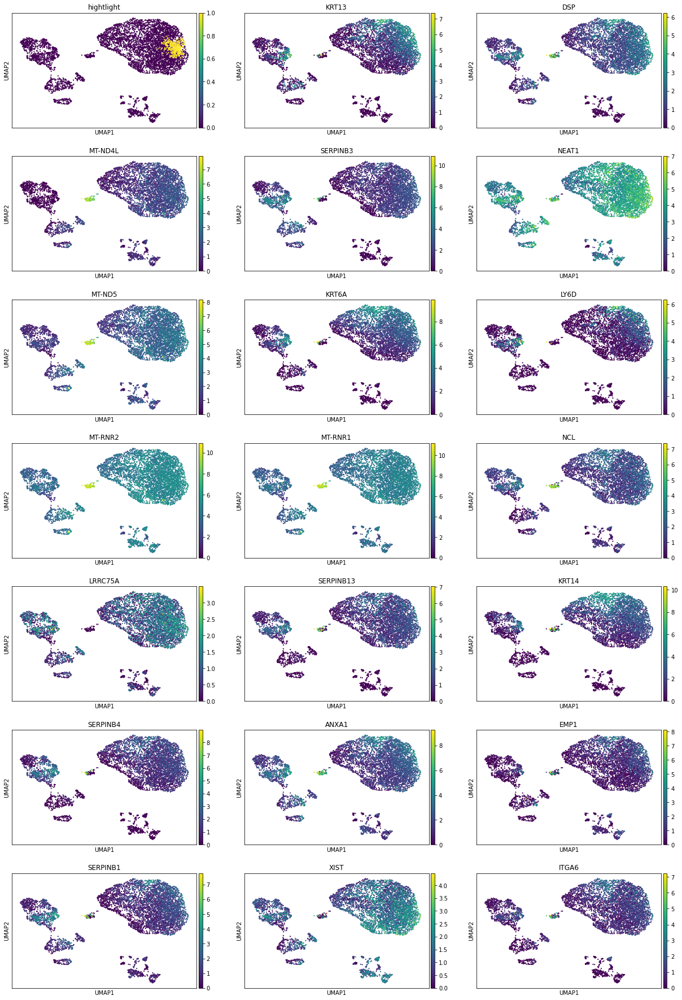

In [27]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


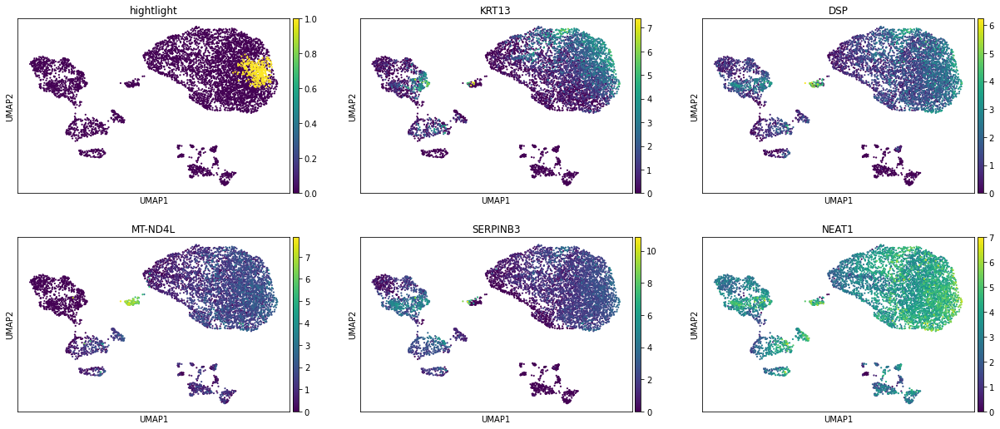

1


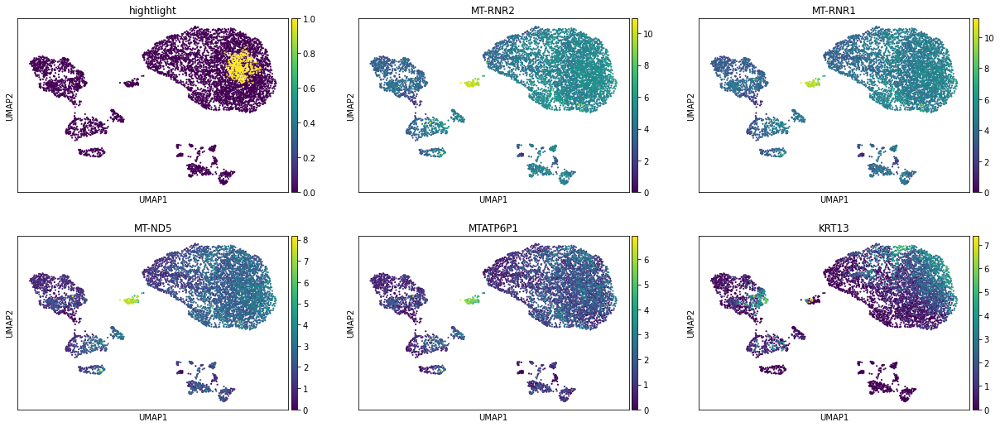

2


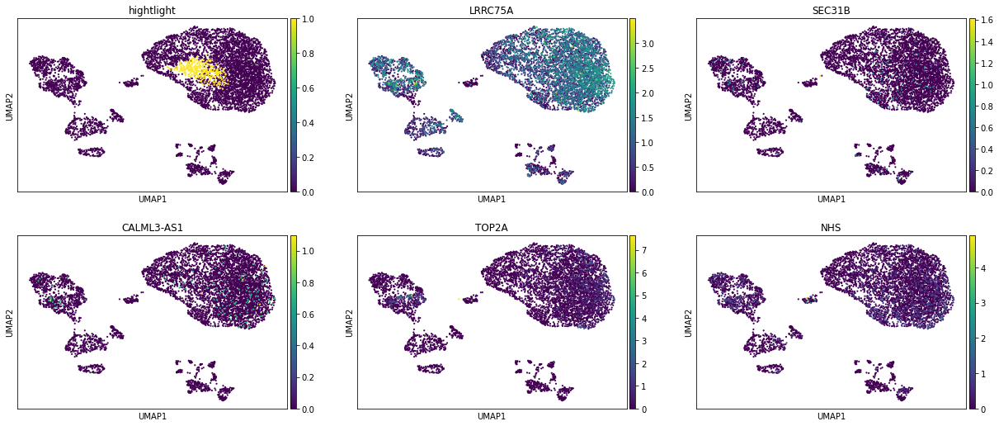

3


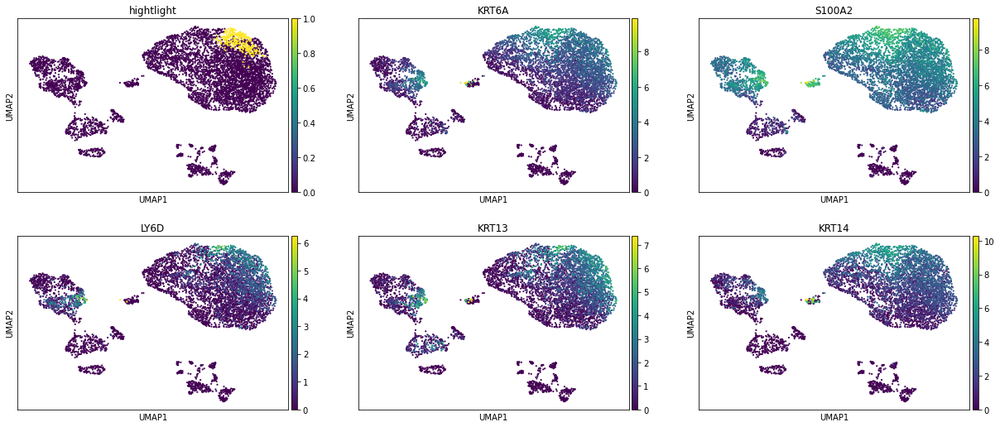

4


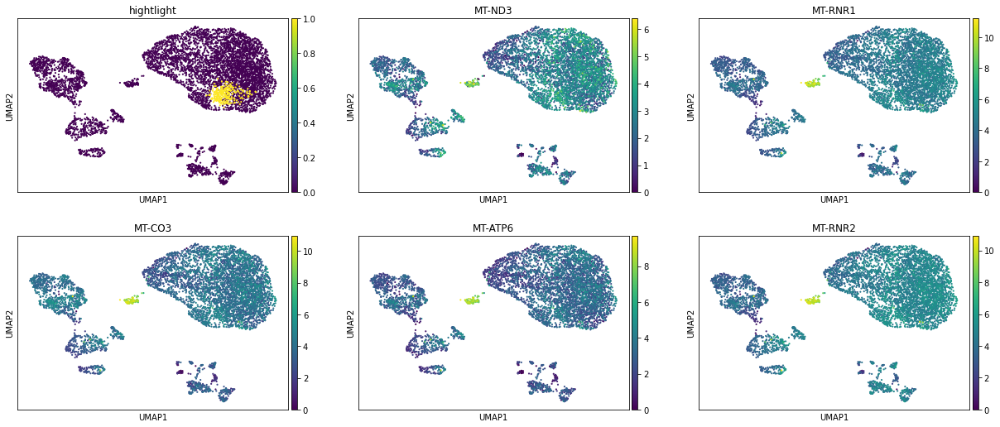

5


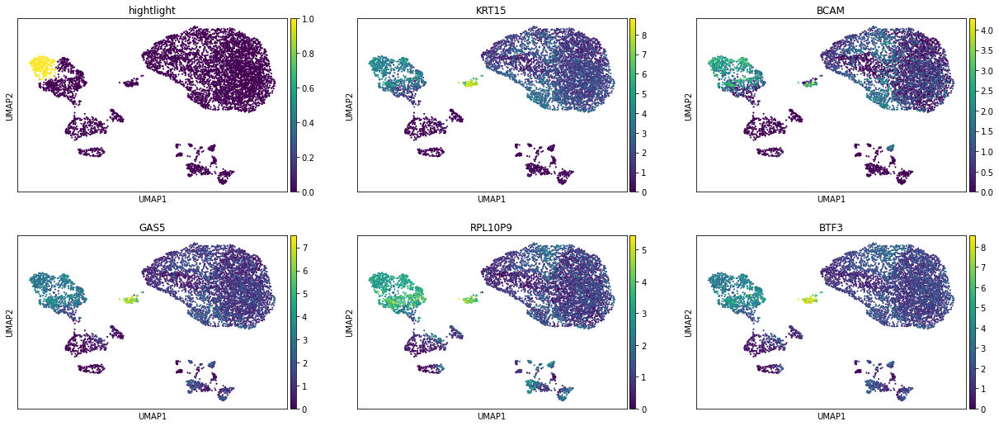

6


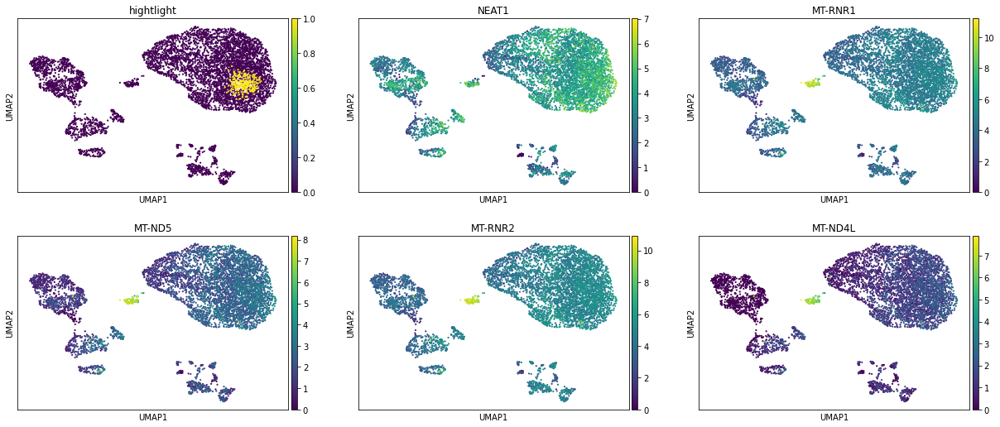

7


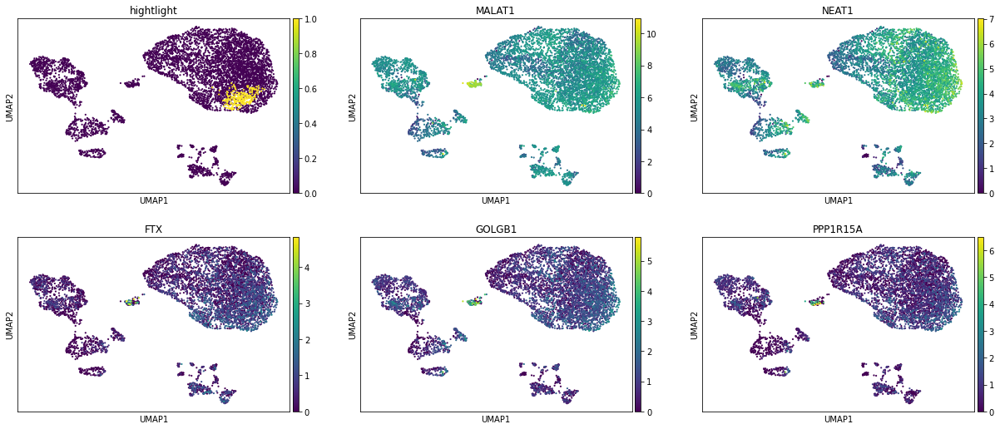

8


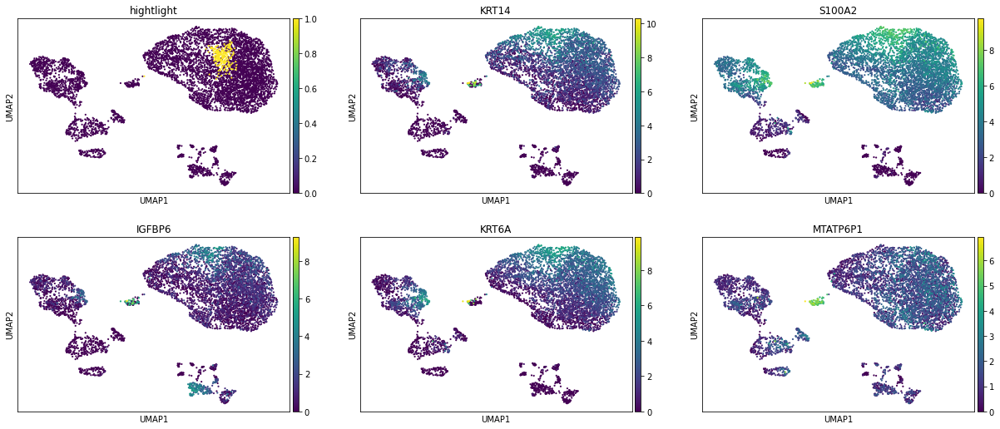

9


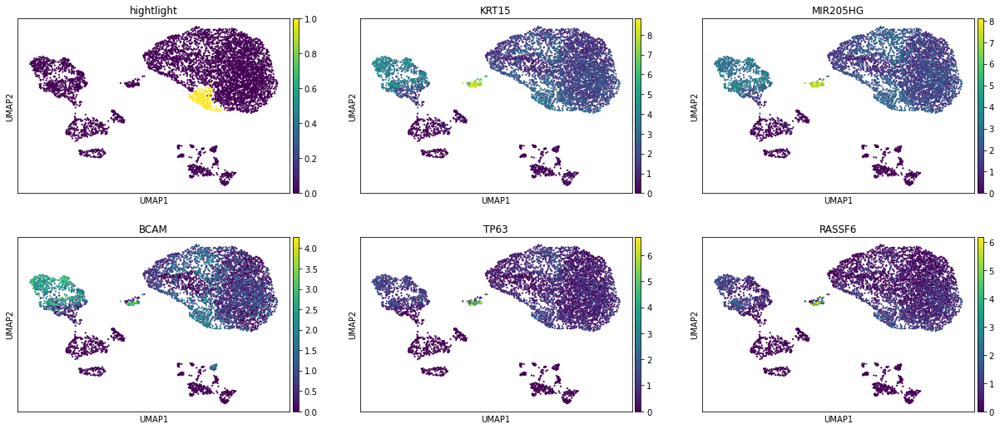

10


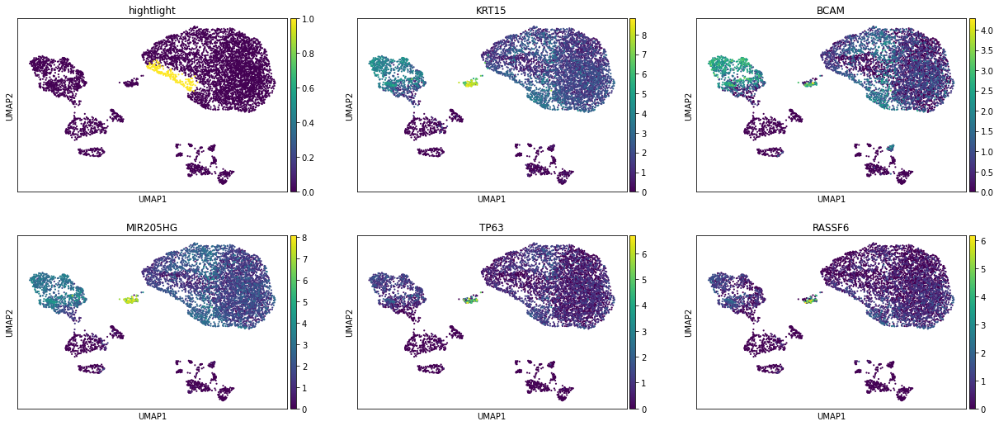

11


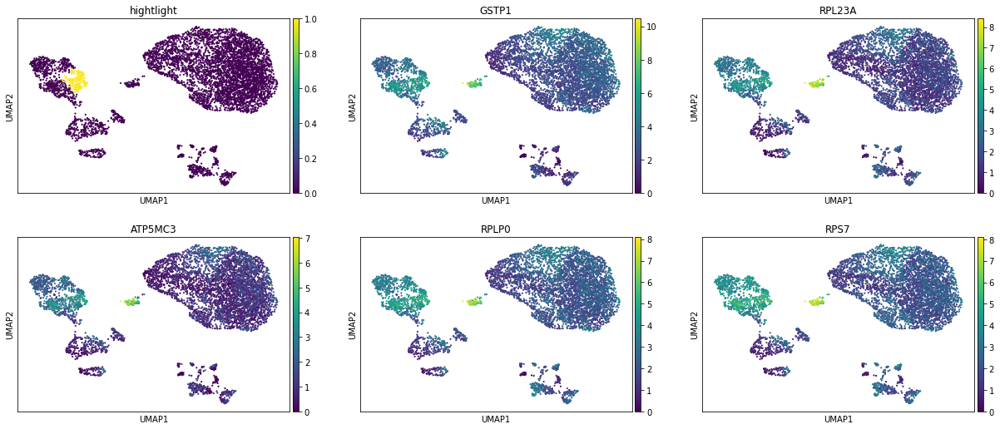

12


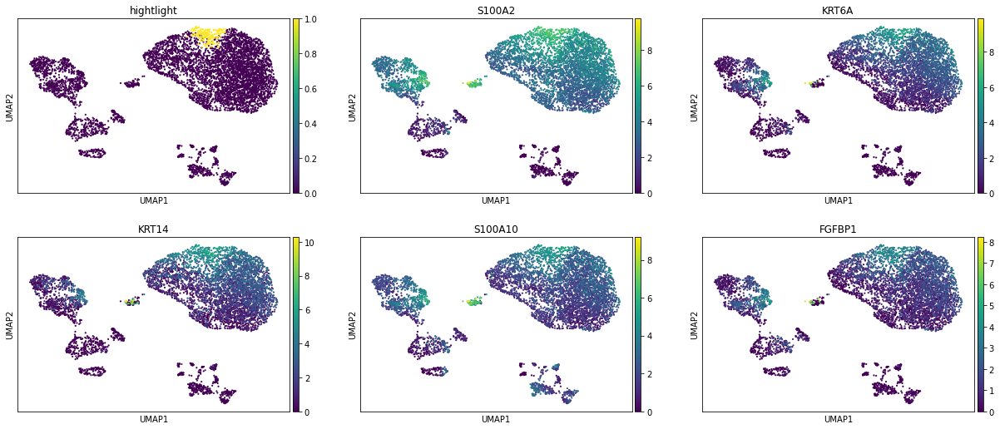

13


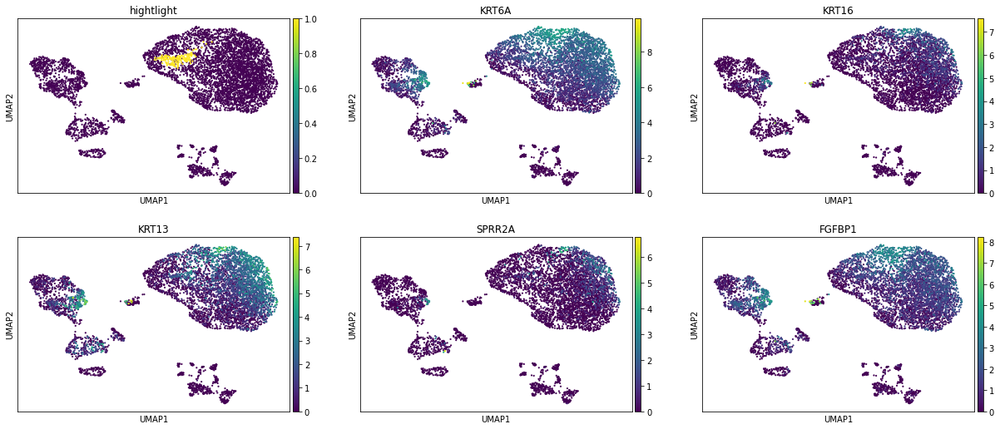

14


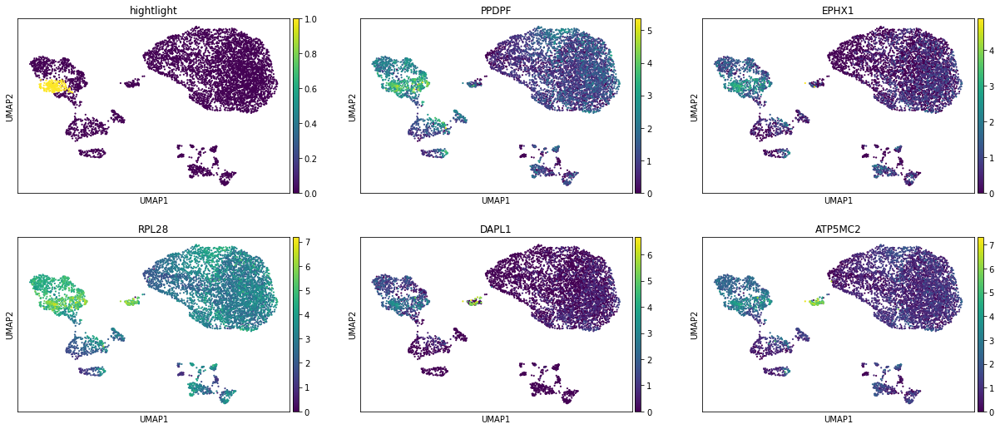

15


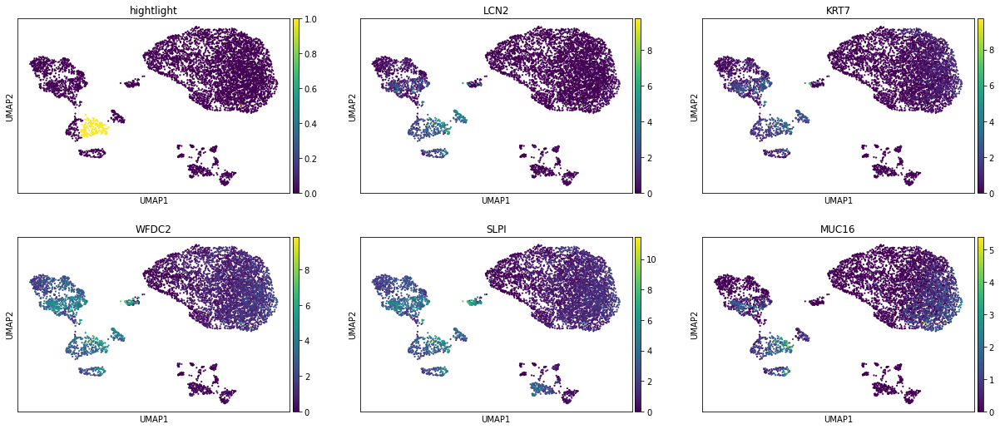

16


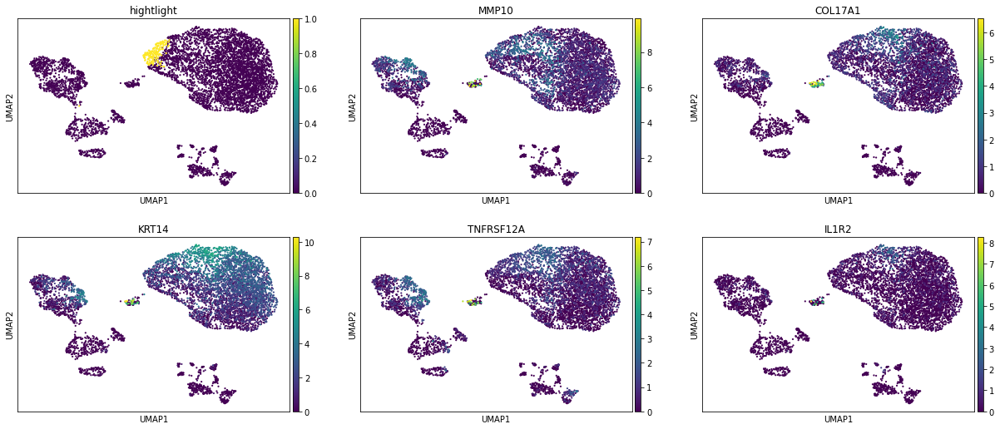

17


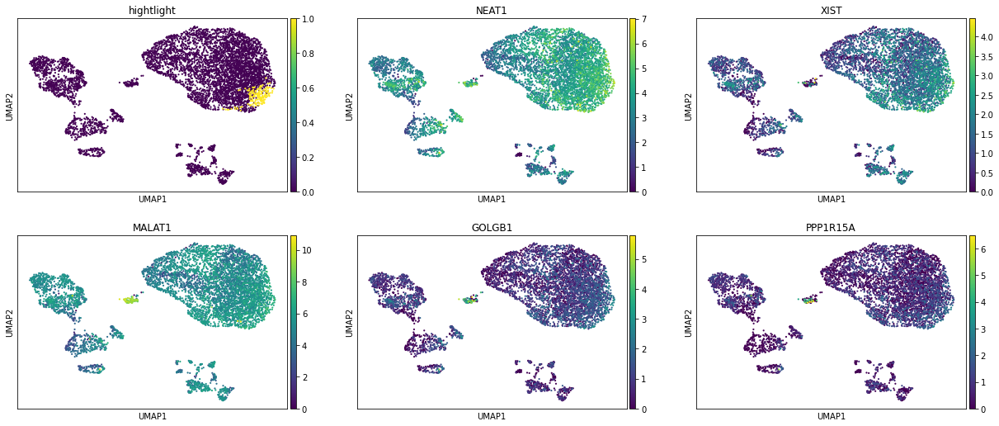

18


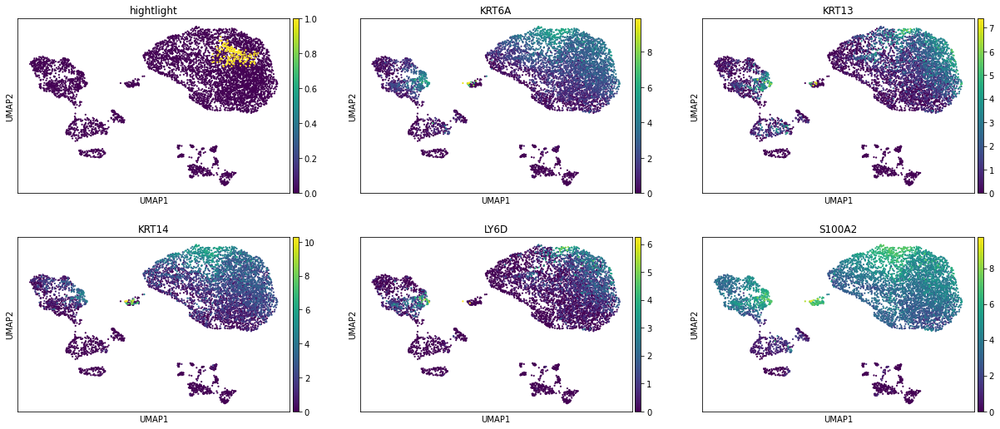

19


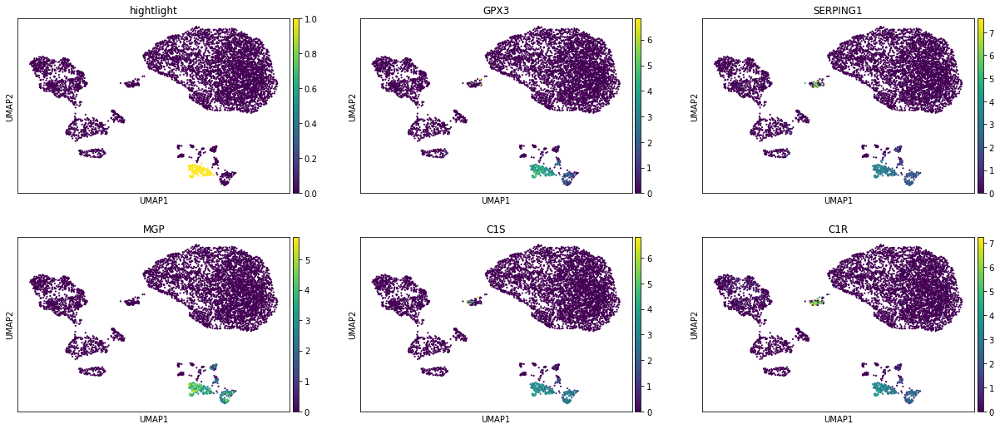

20


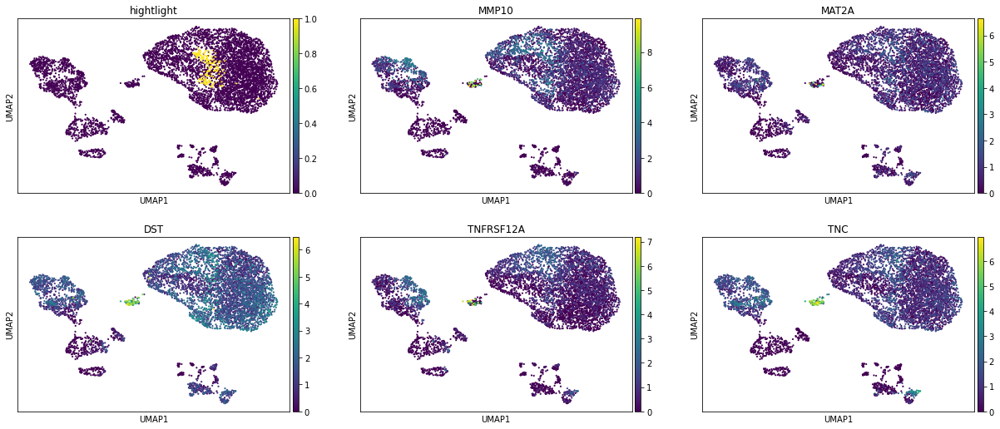

21


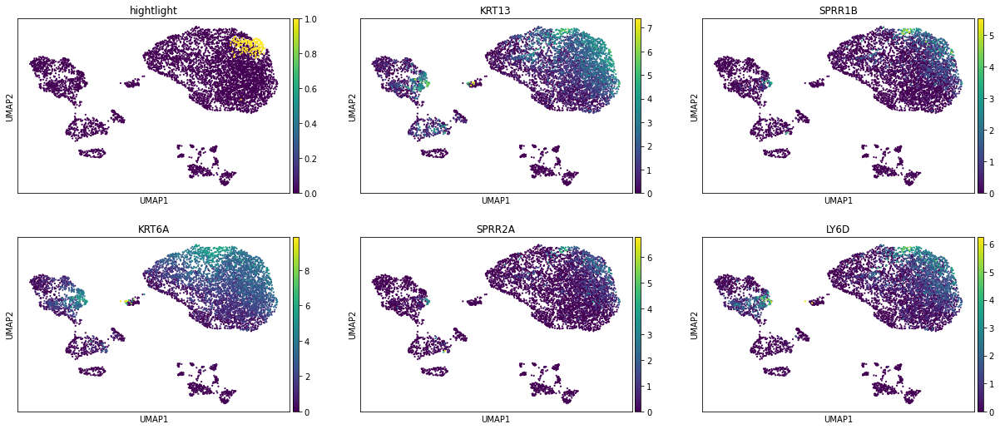

22


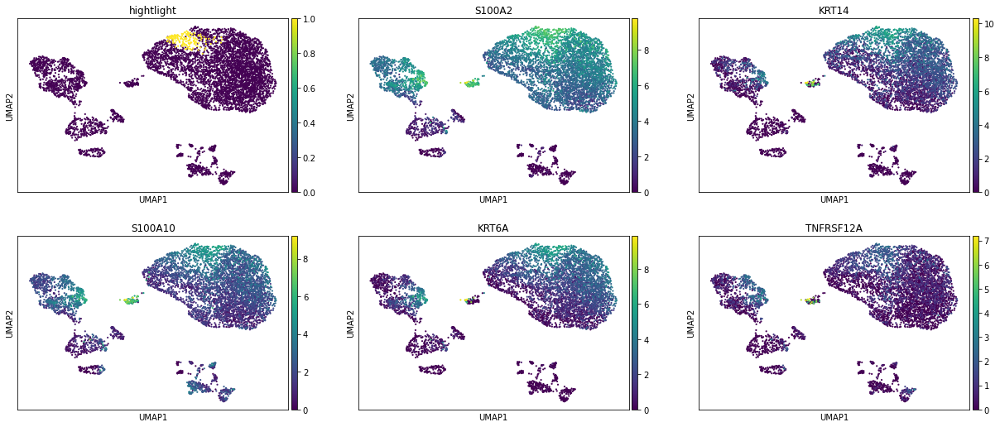

23


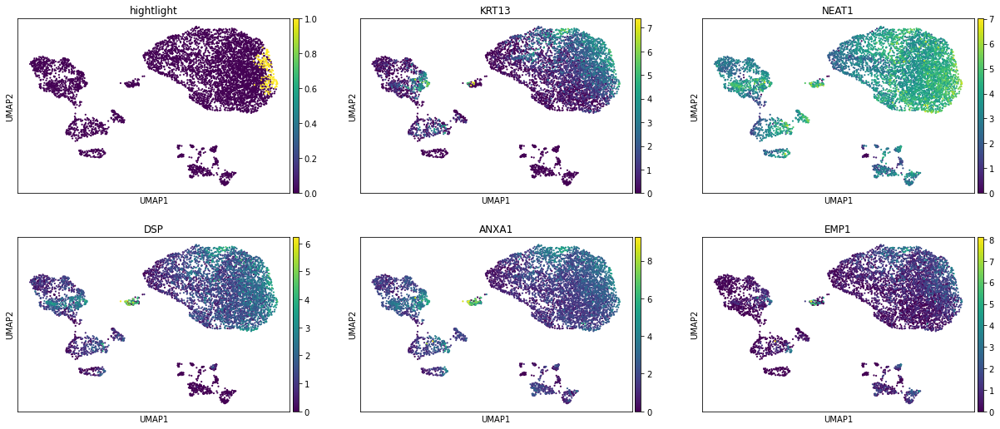

24


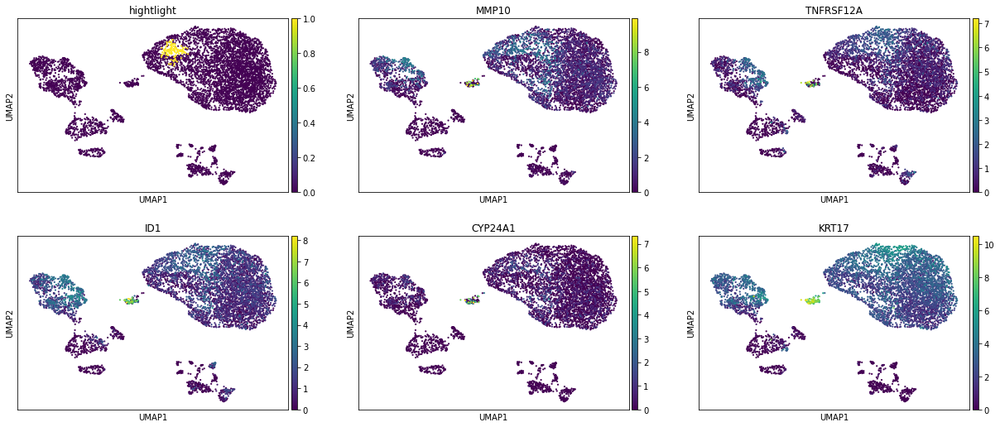

25


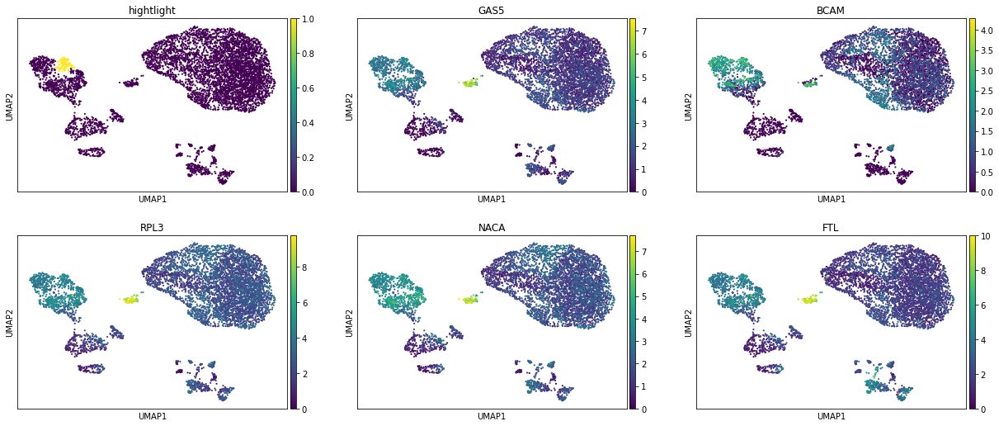

26


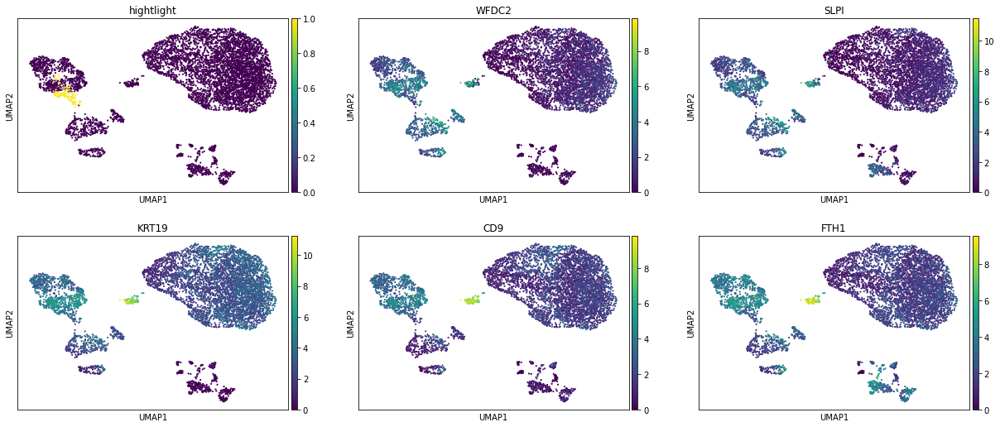

27


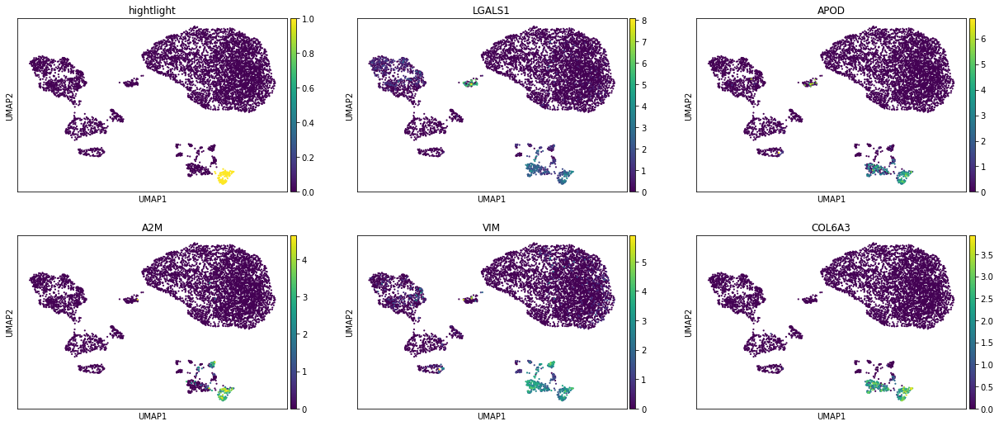

28


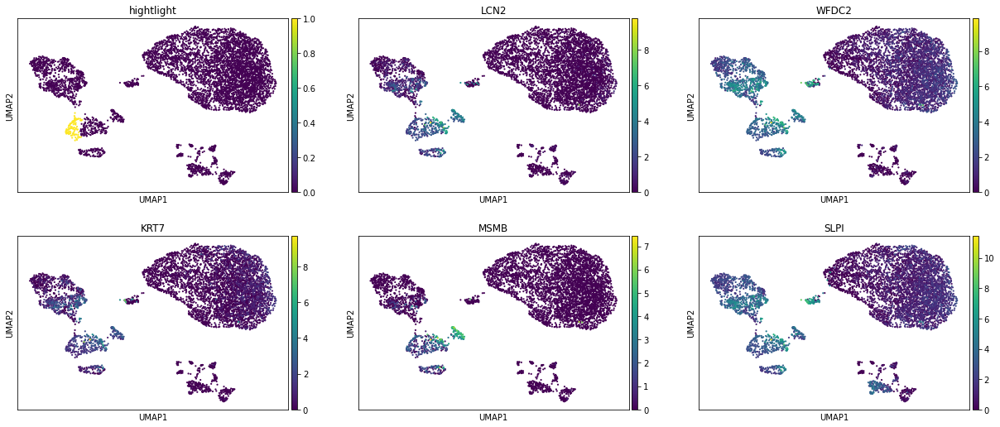

29


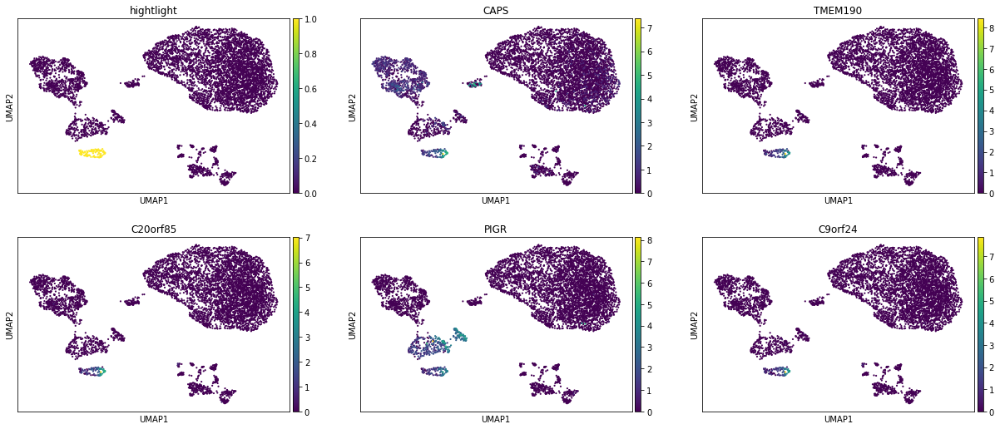

30


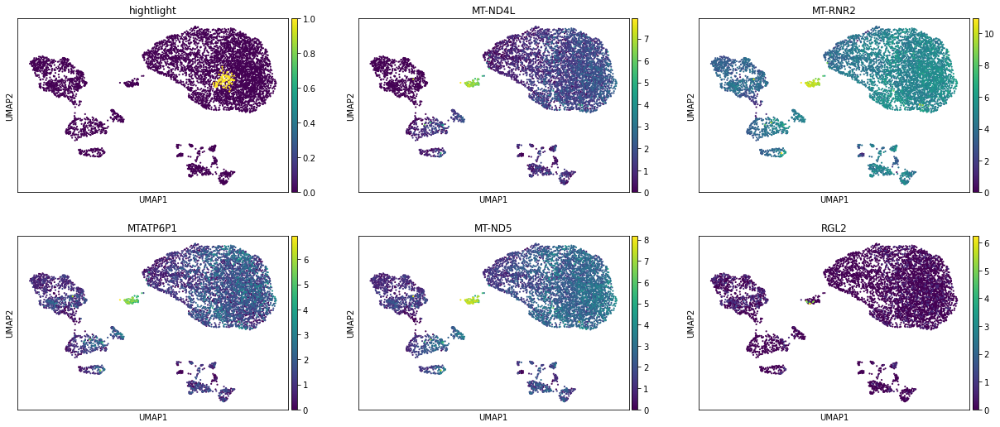

31


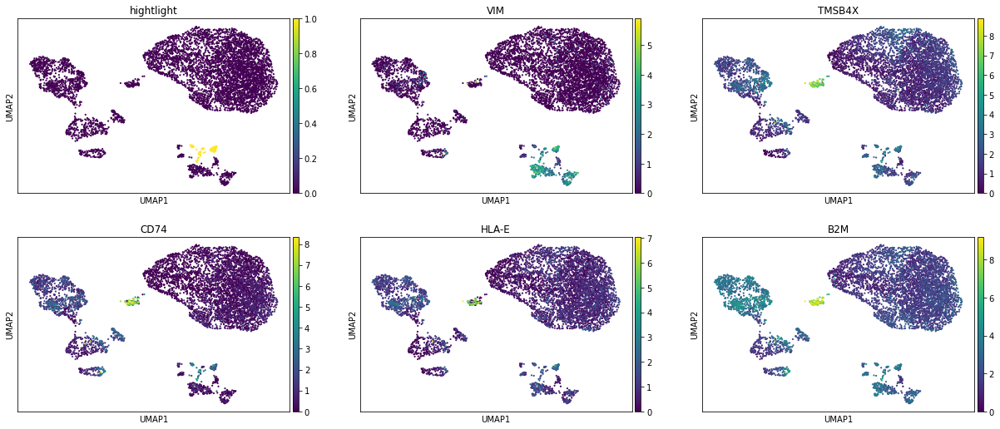

32


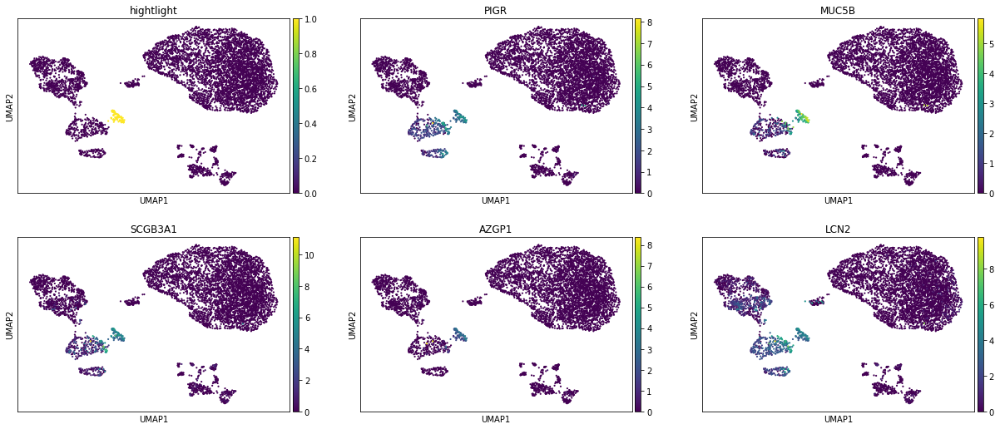

33


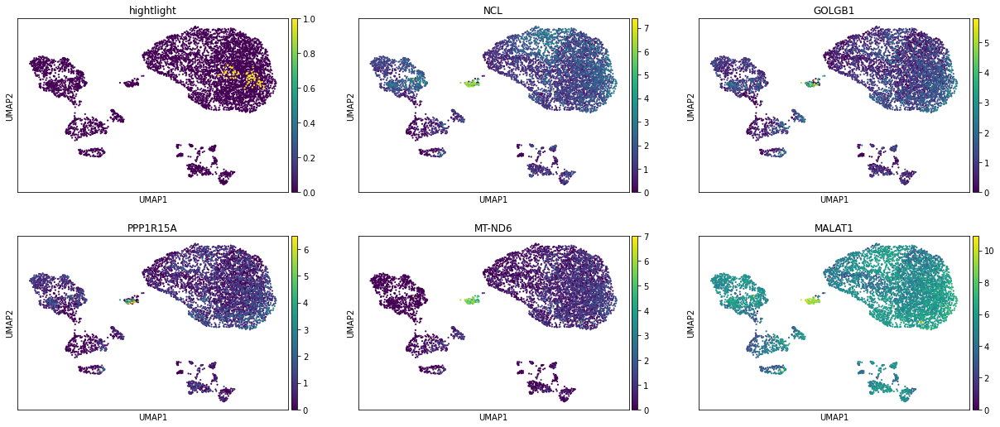

34


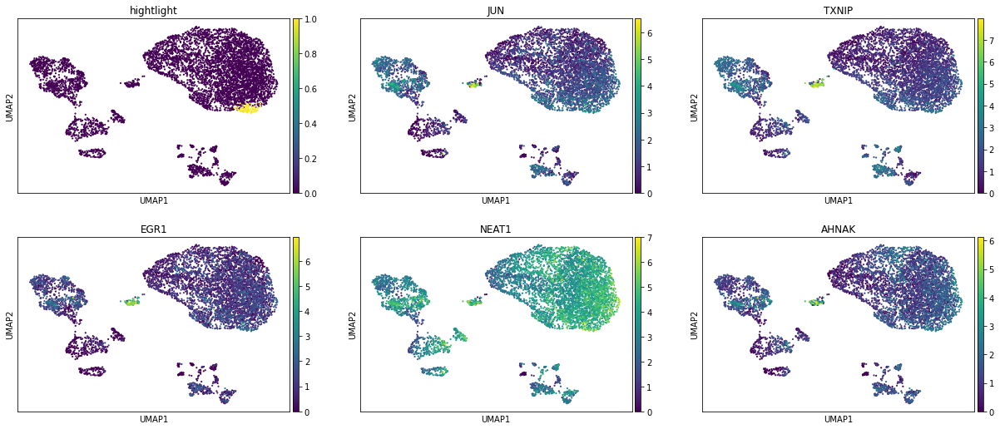

35


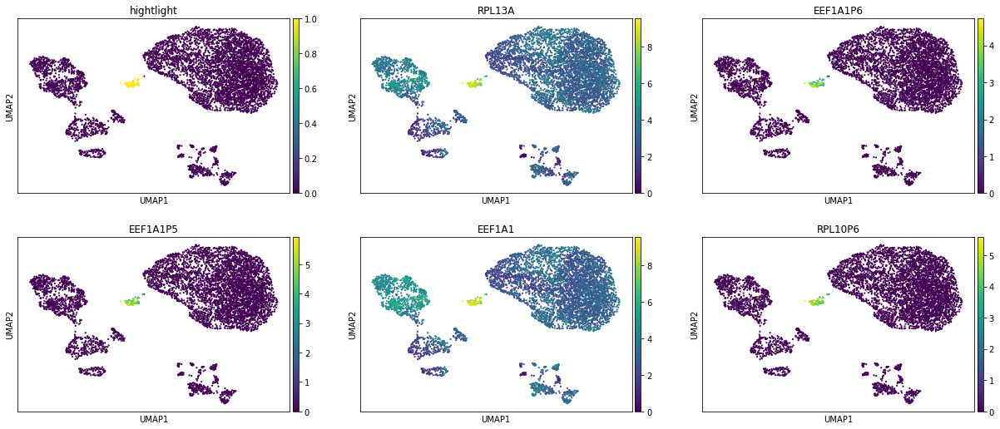

36


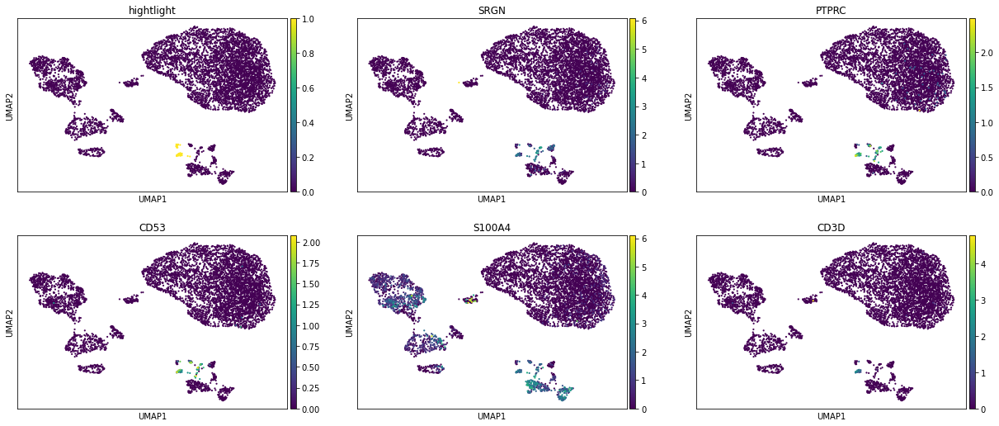

37


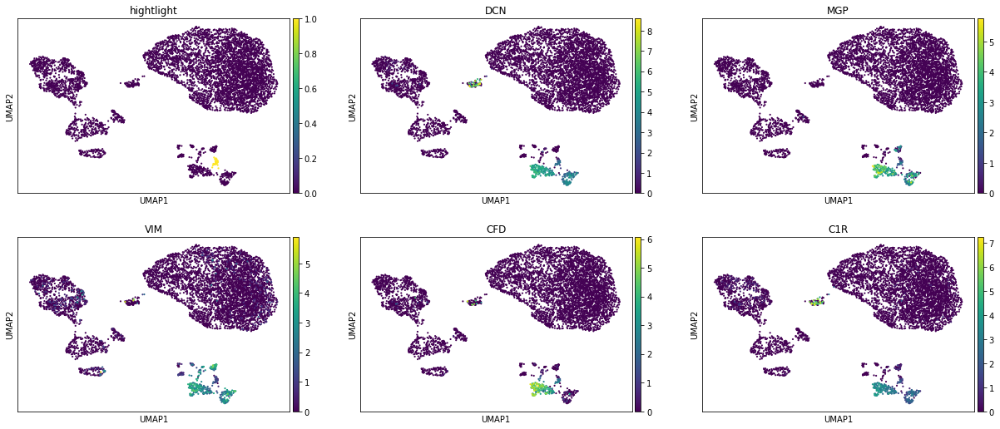

In [28]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [29]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
KRT13,15.813677,1.831024,1.474198e-51
DSP,14.869370,1.272216,1.123764e-45
MT-ND4L,14.863040,1.197770,1.123764e-45
SERPINB3,14.464062,1.298851,3.007855e-43
NEAT1,14.405150,1.100186,5.654694e-43
...,...,...,...
SNHG7,-5.102376,-1.295368,1.361789e-04
UBC,-5.134456,-0.660257,1.164892e-04
NDUFA11,-5.155035,-0.996174,1.073993e-04
RPS10,-5.381988,-1.099842,3.469460e-05


# read in cell ontology 

In [30]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [31]:
celltype_dict["T cell"]

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [32]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-negative, CD8-negative type I NK T cell',
 'activated CD4-positive, alpha-beta T cell',
 'naive thymus-derived CD4-positive, alpha-beta T cell',
 'CD4-positive, alpha-beta memory T cell',
 'CD4-positive, CD25-positive, alpha-beta regulatory T cell',
 'CD4-negative, CD8-negative, alpha-beta intraepithelial T cell',
 'effector memory CD4-positive, alpha-beta T cell',
 'CD4-positive, alpha-beta thymocyte',
 'CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell',
 'activated CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell, human',
 'CD4-negative CD8-negative gamma-delta intraepithelial T cell',
 'central memory CD4-positive, alpha-beta T cell',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'CD4-positive helper T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interleukin-4',
 'activated CD4-negative, CD8-negative type I NK T cell',
 'CD4-intermediate, CD8-positive double-positive thymocyte',
 'CD4-positive, CXCR3-negative, 

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [33]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

This cell will automatically replace the leiden cluster names with cell type annotations

In [34]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,-0.286158,-0.199288,0.639485,-0.496962
log fold change,-23.289829,-23.122492,0.231217,-1.370105
adjusted pvalue,1.000000,1.000000,1.000000,1.000000


# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



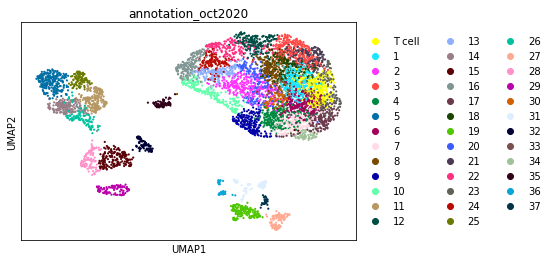

In [35]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# create celltype subcluster
This is just an example once the celltype annotations are done, how to subcluster cells in a celltype

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



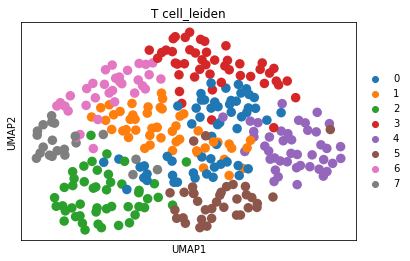

In [36]:
celltype = "T cell"
sub_organ_adata = organ_adata[organ_adata.obs["annotation_oct2020"] == celltype]
sc.pp.neighbors(sub_organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(
    sub_organ_adata,
)
sc.tl.leiden(sub_organ_adata, resolution=1, key_added="%s_leiden" % celltype)
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype],
    ncols=3,
)

In [37]:
sc.tl.rank_genes_groups(
    sub_organ_adata, groupby="%s_leiden" % celltype, method="wilcoxon"
)
sub_DE = FormatDE(sub_organ_adata.uns["rank_genes_groups"])

0


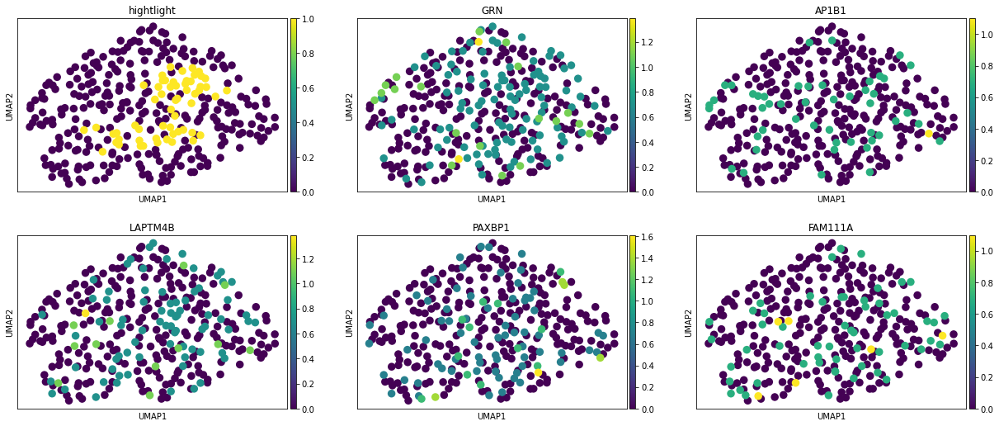

1


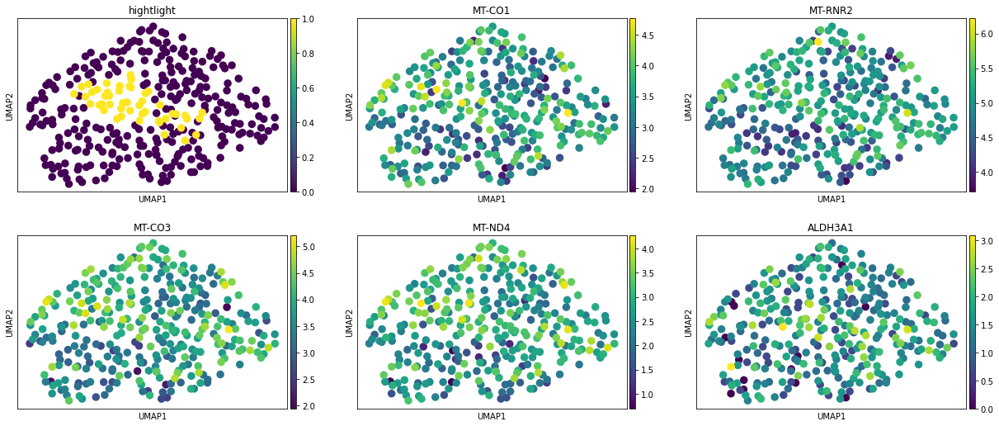

2


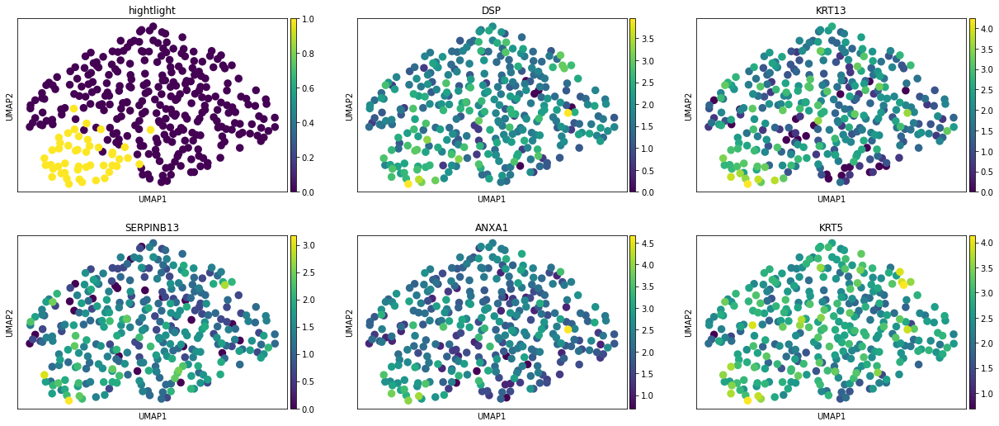

3


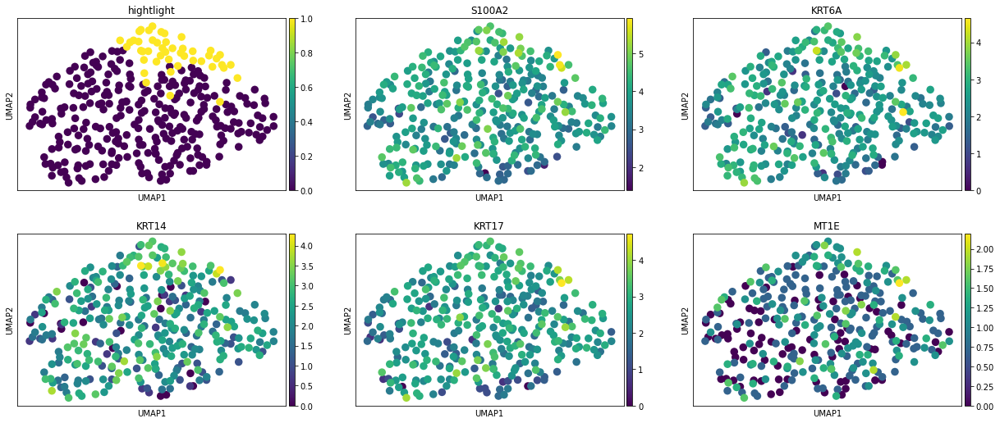

4


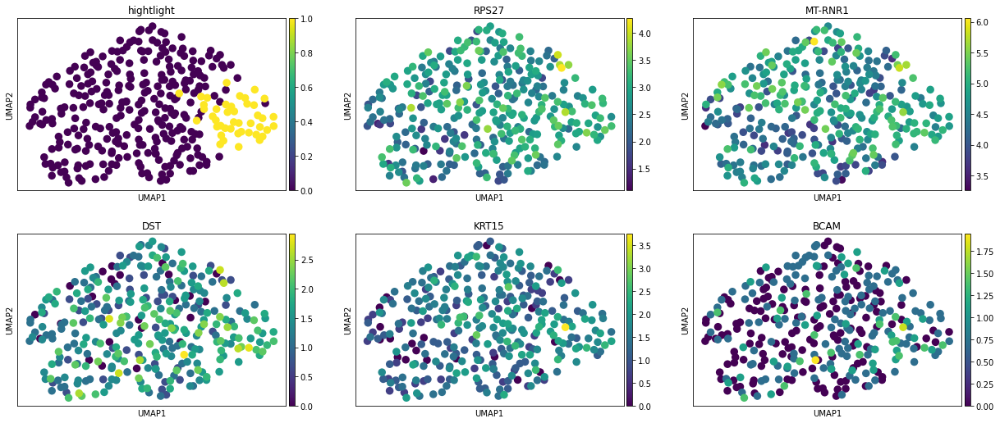

5


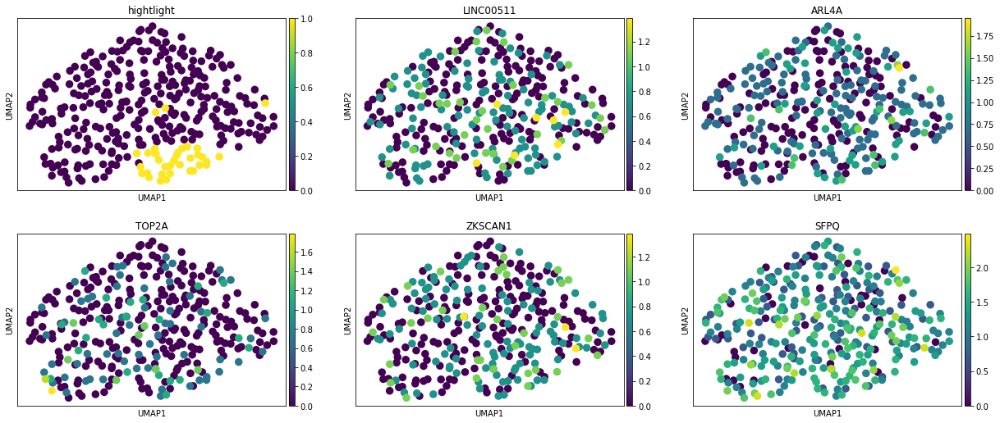

6


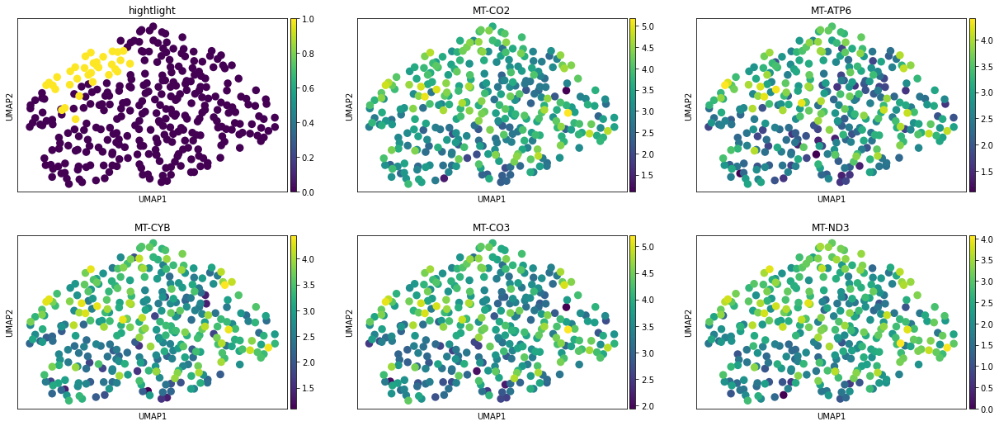

7


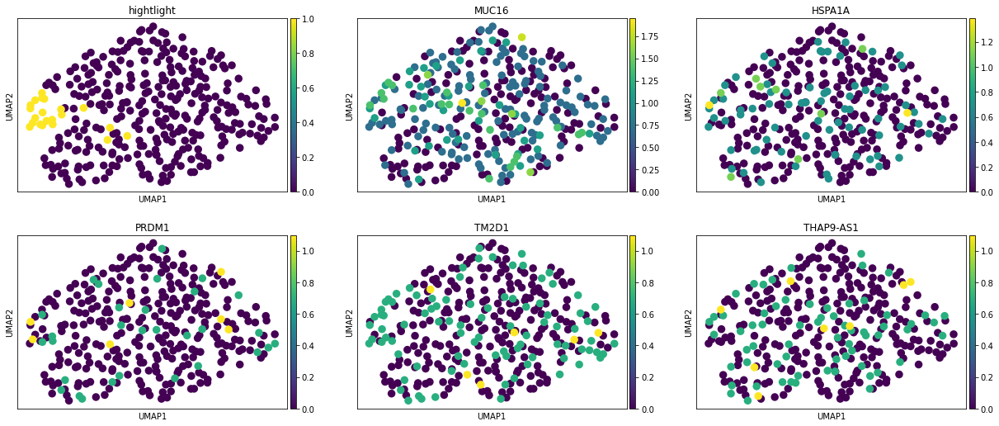

In [38]:
for x in sub_DE.keys():
    print(x)
    topgenes = list(sub_DE[x].T[:5].index)
    sub_organ_adata.obs["hightlight"] = sub_organ_adata.obs["%s_leiden" % celltype] == x
    sc.pl.umap(
        sub_organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

# manually create mapping between cell type and compartment (this is just an example)

In [39]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

This cell will automatically replace the leiden cluster names with cell type annotations

In [40]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

# Visualize the results of the new compartment splitting

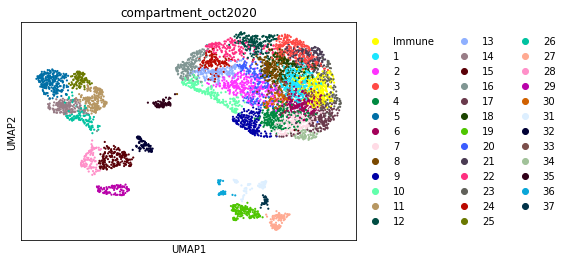

In [41]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [42]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)